# **15 Years of Steam: Marketplace and Genre Trends**

U25013252 Annie Chien

# Business Problem Statement

After the covid pandemic, the video game industry has seen slower  growth and more cost-saving measures. Towards the end of 2023 and continuing into 2024 a large number of layoffs was conducted, with over 10,000 jobs lost in 2023 and at least 8,000 in 2024. Thus, it is becoming more important to make optimal marketing decisions with limited resources to manage risks when launching a new product.

Steam is the largest digital distribution platform for PC gaming, with a dominant market share. In 2023, games worth $9 billion were sold on Steam, accounting for more than 580 million copies.

By diving into the Steam dataset with data from 2007 to 2022, this project aims to:
1. Pinpoint the important features that drive peak concurrent players.
2. Conduct word frequency analysis with NLP to find popular keywords in the game description.
3. Provide a marketing dashboard tool for developers to lookup relevant info, ensuring a successful product launch. [Click here to go to the dashboard](https://public.tableau.com/views/15YearsofSteamMarketplaceandGenreTrends/LandingPage?:language=en-US&:sid=&:redirect=auth&:display_count=n&:origin=viz_share_link)

The goal is to inform video game publishers and developers in optimizing the pricing strategy, product description, and release window of the new products.




# Dataset Description


The SteamGames (71k games) dataset contains comprehensive information on a large collection of games on the Steam platform from 1997-2025, including unreleased games. The dataset consists of 39 columns and 71,171 rows, providing information about game genres, price, number of player and more. This provides a valuable opportunity to delve into the dynamics of the Steam marketplace and observe store page content trends through the years and across different genres.

**Datasource:** https://www.kaggle.com/datasets/mexwell/steamgames


**Data description for games**

| Column Name                 | Data Type  | Description                                                   |
|-----------------------------|------------|---------------------------------------------------------------|
| AppID                       | Integer    | Unique game ID                                                |
| Name                        | String     | Game title                                                    |
| Release date                | Date       | Date game was released                                        |
| Estimated owners            | String    | Estimated number of users that own the game                   |
| Peak CCU                    | Integer    | Peak concurrent players                                       |
| Required age                | Integer    | Age requirement of the game                                   |
| Price                       | Float      | Game price in USD                                             |
| DLC count                   | Integer    | Number of downloadable content for a game                     |
| About the game              | String     | Description of the game on the store page                     |
| Supported languages         | String     | Languages supported by the game                               |
| Full audio languages        | String     | Audio language options of the game                            |
| Reviews                     | String     | Game reviews by media                                         |
| Header image                | String      | Image URL                                                     |
| Website                     | String        | Game website URL                                              |
| Support url                 | String        | Contact support URL                                           |
| Support email               | String     | Contact support email                                         |
| Windows                     | Boolean    | Whether playable on Windows                        |
| Mac                         | Boolean    | Whether playable on Mac                            |
| Linux                       | Boolean    | Whether playable on Linux                          |
| Metacritic score            | Integer    | Game review score on a scale of 0 to 100                      |
| Metacritic url              | String       | Game Metacritic page URL                                      |
| User score                  | Float      | User score on Steam                                           |
| Positive                    | Integer    | Number of positive reviews                                    |
| Negative                    | Integer    | Number of negative reviews                                    |
| Score rank                  | Integer    | Game ranking based on score                                   |
| Achievements                | Integer    | Number of achievements in the game                            |
| Recommendations             | Integer    | Number of Steam user recommendations                          |
| Notes                       | String     | Warnings or terms and conditions                              |
| Average playtime forever    | Float      | Average playtime of a game                                    |
| Average playtime two weeks  | Float      | Average playtime of a game in the last two weeks when data was queried |
| Median playtime forever     | Float      | Median playtime of a game                                     |
| Median playtime two weeks   | Float      | Median playtime of a game in the last two weeks when data was queried |
| Developers                  | String     | Developer name                                                |
| Publishers                  | String     | Publisher name                                                |
| Categories                  | String     | Steam platform feature category                               |
| Genres                      | String     | Game genres                                                   |
| Tags                        | String     | Game tags                                                     |
| Screenshots                 | Integer    | Number of screenshots on the game page                        |
| Movies                      | Integer    | Number of trailer videos on the game page                     |


# Loading the Data and Packages

In [1]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import nltk
nltk.download('stopwords')
nltk.download('punkt')
from nltk import word_tokenize, pos_tag, ne_chunk
from nltk.corpus import stopwords
from nltk.tree import Tree
import string
from collections import Counter
!pip install spacy
!python -m spacy download en_core_web_sm
import spacy
nlp = spacy.load("en_core_web_sm")
from spacy.pipeline import EntityRuler
import unicodedata
from wordcloud import WordCloud

from google.colab import drive
drive.mount('/content/gdrive', force_remount = True)

df = pd.read_csv('/content/gdrive/MyDrive/000_MSBA_courses/BA890_Practicum/games.csv')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.8/12.8 MB 49.3 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')
⚠ Restart to reload dependencies
If you are in a Jupyter or Colab notebook, you may need to restart Python in
order to load all the package's dependencies. You can do this by selecting the
'Restart kernel' or 'Restart runtime' option.
Mounted at /content/gdrive


# Data Cleaning

In [2]:
# Drop NA and non-relevant columns
df.drop(columns= ['Website', 'Support url', 'Support email','Metacritic url', 'User score', 'Reviews', 'Estimated owners','Header image', 'Full audio languages', 'Score rank', 'Notes', 'Categories'], inplace= True)
df.dropna(subset= ['About the game', 'Name', 'Genres'], inplace= True)

In [3]:
# Drop non-logical prices, set date range from 2007-2022, and only get games with Metacritic scores
df['Release date'] = pd.to_datetime(df['Release date'], format='mixed')
df = df[df['Price'] < 150]
df = df[(df['Release date'] >= '2007-01-01') & (df['Release date'] < '2023-01-01')]
df = df[df['Metacritic score'] > 0]

In [4]:
# Count number of screenshots and videos each game page has
df[['Screenshots', 'Movies']] = df[['Screenshots', 'Movies']].astype(str)

def count_strings(text):
    return len(text.split(','))

df['Screenshot_count'] = df['Screenshots'].apply(count_strings)
df['Movie_count'] = df['Movies'].apply(count_strings)
df['Languages_count'] = df['Supported languages'].apply(count_strings)

df.drop(columns=['Screenshots', 'Movies'], inplace= True)

In [5]:
# Split the Tags and Genres column and explode the DataFrame

df['Tags'] = df['Tags'].str.strip('[]').str.replace("'", "", regex=False).str.split(',')
df['Genres'] = df['Genres'].str.strip('[]').str.replace("'", "", regex=False).str.split(',')
exploded_df = df.explode('Genres')
exploded_df = exploded_df.explode('Tags')

# EDA

## Peak CCU and Metacritic Score Correlation Analysis

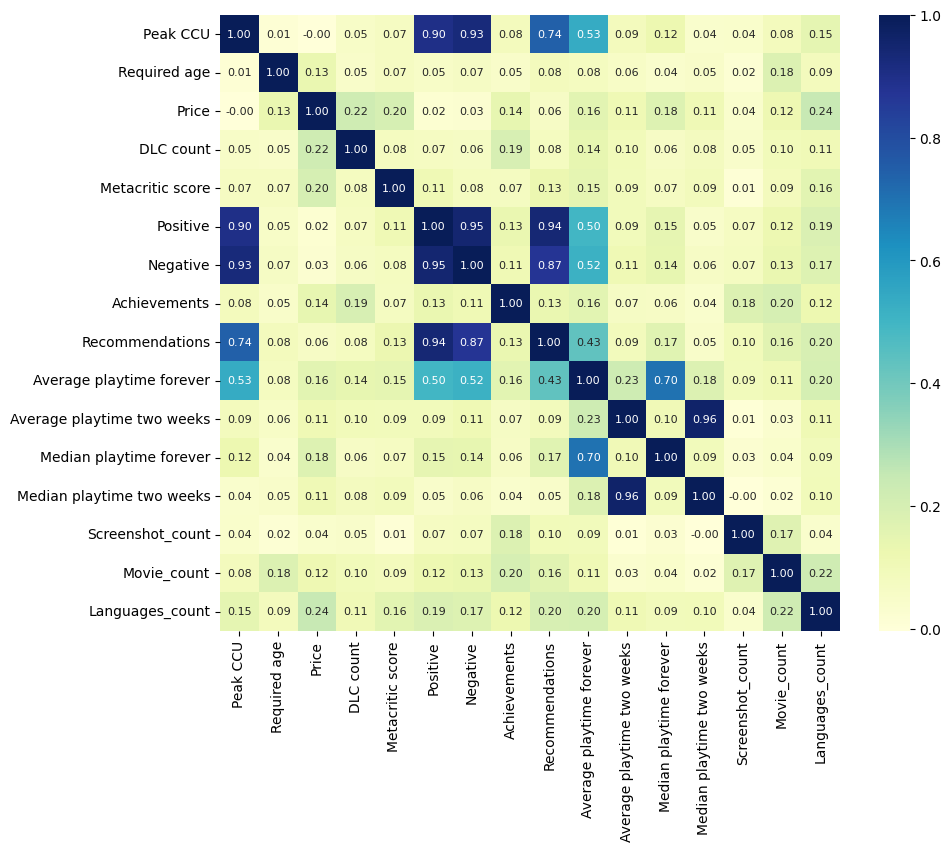

In [6]:
#Correlation Matrix
numeric_df = df.select_dtypes(include=['number'])
numeric_df = numeric_df.drop(columns=['AppID'])
corr_matrix = numeric_df.corr()
fig, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(corr_matrix, fmt=".2f", annot=True, cmap='YlGnBu', annot_kws={"size": 8})
plt.show();

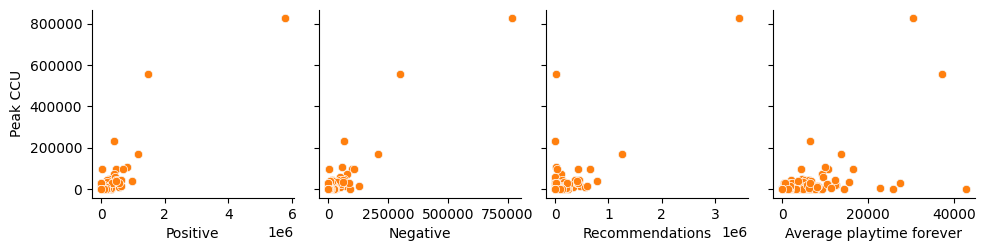

In [7]:
# Scatterplot of Peak CCU and other correlated variables
y_var = 'Peak CCU'
x_vars = ['Positive', 'Negative', 'Recommendations', 'Average playtime forever']
g = sns.pairplot(numeric_df, x_vars=x_vars, y_vars=[y_var])
g.map(sns.scatterplot)
plt.show()

Peak concurrent players and review scores are two key factors that influence game sales. Concurrent players can be used as an indicator for sales, since people need to buy or own the games in order to be online. As for Metacritic score, word-of-mouth is important when players are deciding on a purchase for the gaming community. The review scores from major media outlets have an even larger impact on the amount of units sold.

Taking a closer look at Peak CCU as the target variables in the correlation matrix, it is observed that:

* The number of positive reviews, negative reviews, and recommendations are more correlated with Peak CCU. It is expected that positive reviews and recommendations will drive more players to play the game. However, it is interesting to note that negative reviews also drive peak concurrent players. From the data, multiplayer games have the second highest Peak CCU. Therefore one assumption is online games that are updated frequently invites more chances to negative player feedback but newly updated content will also attract player curiosity to go online.

Taking a look at the Metacritic score:
* It is harder to find correlated variables. It can be assumed that there are more factors involved when reviewers review a game. In addition, the variables available in the dataset has more to do with information on the Steam platform, as opposed to information about the game itself, which reviewers often base their reviews on, such as: length of the game, art style, and game modes. Gathering data on the game characteristics is a potential next step for futher analysis.

In [8]:
# Average metacritic score by tag breakdown, filtered by tags with more than 100 games

tag_avg_scores = exploded_df.groupby('Tags')['Metacritic score'].agg(['mean', 'count']).reset_index()
tag_avg_scores.columns = ['Tag', 'Average Metacritic Score', 'Number of Games']
tag_avg_scores = tag_avg_scores.sort_values('Average Metacritic Score', ascending=False)
tag_avg_scores_100_games = tag_avg_scores[tag_avg_scores['Number of Games'] >= 100]
print(tag_avg_scores_100_games.head(10))

               Tag  Average Metacritic Score  Number of Games
20       Addictive                 79.161017              118
398        VR Only                 77.386139              101
311        Romance                 76.927632              152
227       Moddable                 76.865633              387
1            1990s                 76.822222              180
76         Classic                 76.814925              670
5    2D Platformer                 76.748899              227
196   Level Editor                 76.695187              187
171       Hex Grid                 76.584746              118
220   Metroidvania                 76.529274              427


In [9]:
# Average metacritic score by genre breakdown, , filtered by genre with more than 100 games
genre_avg_scores = exploded_df.groupby('Genres')['Metacritic score'].agg(['mean', 'count']).reset_index()
genre_avg_scores.columns = ['Genre', 'Average Metacritic Score', 'Number of Games']
genre_avg_scores = genre_avg_scores.sort_values('Average Metacritic Score', ascending=False)
genre_avg_scores_100_games = genre_avg_scores[genre_avg_scores['Number of Games'] >= 100]
print(genre_avg_scores_100_games.head(10))

                    Genre  Average Metacritic Score  Number of Games
4            Free to Play                 74.685185             1620
9                     RPG                 74.347616            13466
13                 Sports                 74.247319             1585
0                  Action                 73.996069            30021
7   Massively Multiplayer                 73.965182             1235
14               Strategy                 73.930962            13239
1               Adventure                 73.710317            26964
2                  Casual                 73.380014             6955
6                   Indie                 73.340038            32664
10                 Racing                 72.763971             1682


Drilling down on Metacritic score by tag and genre, two observations can be made.

First, remember that tags on Steam are similar to tags on social media. Publishers can choose how to tag their games. This means tags tend to be more specific than genres. To avoid tags that are too specific (like "batman"), the data was filtered to only include tags associated with at least 100 games. The "addictive" tag had the highest average Metacritic score. This suggests that games tagged as "addictive" tend to be well-received by critics, possibly indicating a higher level of engagement and well-crafted gameplay loop/system that makes the reviewers keep wanting to go back. However, it's important to note that correlation does not equal causation, and other factors might contribute to both high review scores and the "addictive" tag.

Looking at the top ten highest-scored genres, the scores are very close. For single-player games, the RPG genre has the highest average Metacritic score. This could indicate that RPGs generally offer deeper and more nuanced experiences that resonate with critics. However, the close scores across genres suggest that quality games can be found in any genre.

Publishers can use this information to decide which tags to include or avoid. For example, highlighting addictive qualities in a game's marketing could be beneficial, while being cautious about overusing generic tags might be advisable. A combination of general and specific tags to capture the maximum amount of eyeballs might be advised. Understanding the critical reception of different genres can also inform decisions about game development and marketing strategies.

Further analysis could explore the relationship between specific tags and genres, and how they impact Metacritic scores. This could involve looking at the prevalence of certain tags within top-rated genres, or examining how the combination of tags and genres affects critical reception.

In [10]:
# Peak CCU by tag breakdown
tag_peak_ccu_sum = exploded_df.groupby('Tags')['Peak CCU'].agg(['sum', 'count']).reset_index()
tag_peak_ccu_sum.columns = ['Tags', 'Total Peak CCU', 'Number of Games']
tag_peak_ccu_sum = tag_peak_ccu_sum.sort_values('Total Peak CCU', ascending=False)
print(tag_peak_ccu_sum.head(10))

             Tags  Total Peak CCU  Number of Games
15         Action         9341835             5234
233   Multiplayer         9181672             2583
78          Co-op         8086595             1705
288           PvP         6028770              515
255  Online Co-Op         5901242              741
351      Strategy         5215498             2657
145  First-Person         5070097             1403
365    Team-Based         4811464              216
323       Shooter         4707814             1201
328  Singleplayer         4570212             6209


In [11]:
# Peak CCU by genre breakdown
genre_peak_ccu_sum = exploded_df.groupby('Genres')['Peak CCU'].agg(['sum', 'count']).reset_index()
genre_peak_ccu_sum.columns = ['Genres', 'Total Peak CCU', 'Number of Games']
genre_peak_ccu_sum = genre_peak_ccu_sum.sort_values('Total Peak CCU', ascending=False)
print(genre_peak_ccu_sum.head(10))

                   Genres  Total Peak CCU  Number of Games
0                  Action        66167181            30021
4            Free to Play        40280869             1620
14               Strategy        23366771            13239
1               Adventure        22402732            26964
9                     RPG        18466047            13466
6                   Indie        14132597            32664
12             Simulation        12599060             8660
7   Massively Multiplayer         9198408             1235
13                 Sports         1990782             1585
2                  Casual         1761432             6955


Comparing total peak CCU by tag and by genre, it is more evident that the popular usage of tags is to highlight the specific game modes or characteristics, such as: Co-op (cooperation), First-person (first-person camera), and team-based. For publishers, the basic genre and tag usage strategy is to define a main genre for a game and use tags to hone in on the playstyle.



# Keyword Analysis of Game Descriptions with NLP

To further optimize the game page for player discovery, the wording of the game description, which is a short introduction to the game, is crucial. Incorporating SEO concepts is a common tactic for publishers; thus, using NLP to find the correct keywords can serve as a first step to land better search result placement.

## Keyword Analysis of the Most Popular Genre (Action) Game Descriptions

In [12]:
action_df = exploded_df[exploded_df['Genres'] == 'Action']
action_df = action_df[['AppID', 'Name', 'About the game']]

def remove_non_text_characters(text):
    # Define characters that are considered "text" based on Unicode categories
    allowed_categories = {'Lu', 'Ll', 'Lt', 'Lm', 'Lo',
                          'Nd',
                          'Mn', 'Mc',
                          'Zs'}
    # Remove punctuation and symbols
    translator = str.maketrans('', '', string.punctuation + '‘’“”´`–…·•')
    text = text.translate(translator)
    # Filter characters based on Unicode categories
    cleaned_text = ''.join(ch for ch in text if unicodedata.category(ch) in allowed_categories)
    return cleaned_text

# remove or replace meaningless words manually
def process_row(row):
    about = row['About_cleaned']
    name = row['Name_cleaned']
    if name in about or "game" in about or "swipe swipe swipe" in about or "bark bark bark" in about:
        about = about.replace(name, "TITLE")
        about = about.replace("game", "")
        about = about.replace("swipe swipe swipe", "")
        about = about.replace("bark bark bark", "")
        #about = about.replace("play", "")
    return about

# remove stop words
stop_words = set(stopwords.words('english'))
def remove_stop_words(text):
    doc = nlp(text)
    tokens = [token.text for token in doc if token.text.lower() not in stop_words and not token.is_punct]
    return ' '.join(tokens)

# extract and remove entities with NER
def perform_ner(text):
    doc = nlp(text)
    entities = [(ent.text, ent.label_) for ent in doc.ents]
    return entities

def extract_non_entity_tokens(text, entities):
    doc = nlp(text)
    entity_texts = [ent[0] for ent in entities]
    return [token.text.lower() for token in doc if token.text not in entity_texts and not token.is_punct and not token.is_space]

# Apply functions
action_df['About_cleaned'] = action_df['About the game'].apply(remove_non_text_characters).str.lower()
action_df['Name_cleaned'] = action_df['Name'].apply(remove_non_text_characters).str.lower()
action_df['All_cleaned'] = action_df.apply(process_row, axis=1)
clean_text = action_df['All_cleaned'].apply(remove_stop_words)

entities = clean_text.apply(perform_ner)
non_entity_tokens = []
for text, ents in zip(clean_text, entities):
    non_entity_tokens.append(extract_non_entity_tokens(text, ents))

In [13]:
# Frequency Analysis
flattened_tokens = [token for sublist in non_entity_tokens for token in sublist] # Flatten list of lists
word_freq = Counter(flattened_tokens)
print("Word Frequency:", word_freq)

# Count bigrams
bigrams = list(nltk.bigrams(flattened_tokens))
bigram_counts = Counter(bigrams)
bigram_freq = {' '.join(bigram): count for bigram, count in bigram_counts.items()}
print(bigram_freq)

# Count trigrams
trigrams = list(nltk.trigrams(flattened_tokens))
trigram_counts = Counter(trigrams)
trigram_freq = {' '.join(trigram): count for trigram, count in trigram_counts.items()}
print(trigram_freq)

Word Frequency: Counter({'new': 47981, 'play': 38753, 'world': 35199, 'players': 22103, 'unique': 20786, 'experience': 20764, 'features': 20511, 'weapons': 20331, 'enemies': 18741, 'combat': 17701, 'mode': 16673, 'take': 16419, 'story': 16095, 'action': 15931, 'time': 15661, 'way': 15142, 'explore': 14037, 'use': 13993, 'fight': 13729, 'battle': 13294, 'multiplayer': 13015, 'characters': 12736, 'every': 11767, 'different': 11726, 'online': 11079, 'system': 11058, 'player': 10645, 'levels': 10589, 'like': 10442, 'make': 10282, 'abilities': 10177, 'friends': 10129, 'get': 9621, 'key': 9581, 'coop': 9543, 'skills': 9508, 'including': 9406, 'discover': 9391, 'set': 9297, 'even': 9180, 'find': 9089, 'team': 9017, 'war': 8859, 'character': 8814, 'adventure': 8790, 'must': 8701, 'choose': 8627, 'across': 8423, 'powerful': 8270, 'nt': 8204, 'modes': 8086, 'level': 8080, 'enemy': 8079, 'original': 8013, 'control': 8008, 'full': 7955, 'back': 7644, 'become': 7430, 'campaign': 7408, 'create': 736

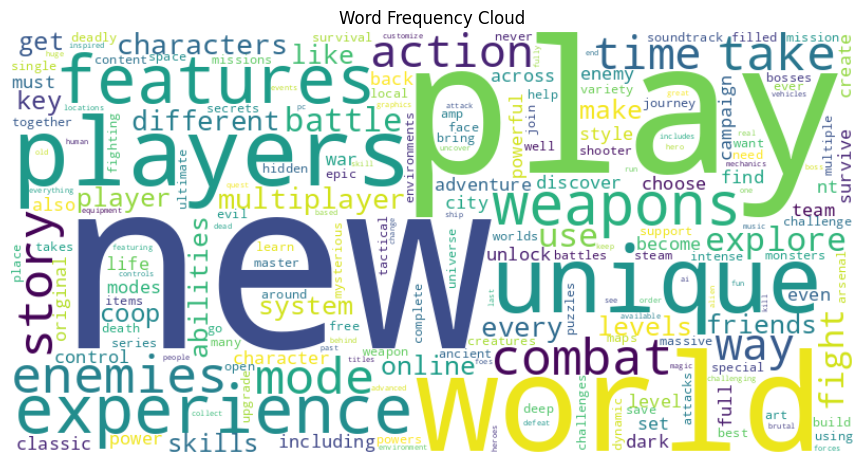

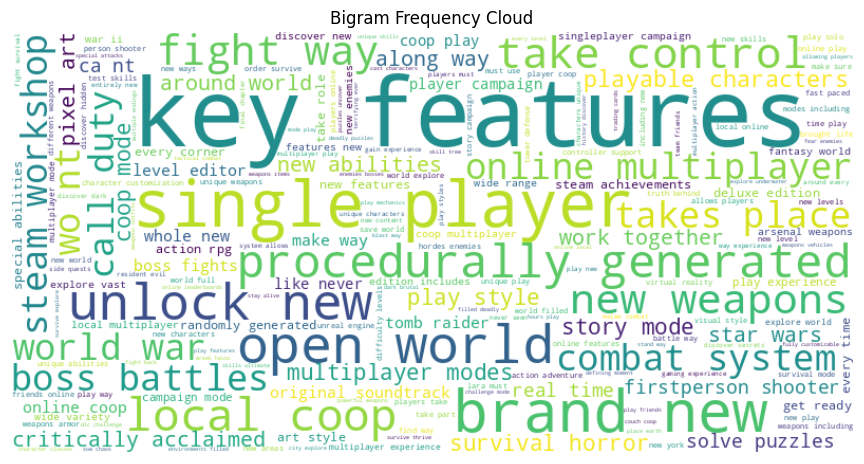

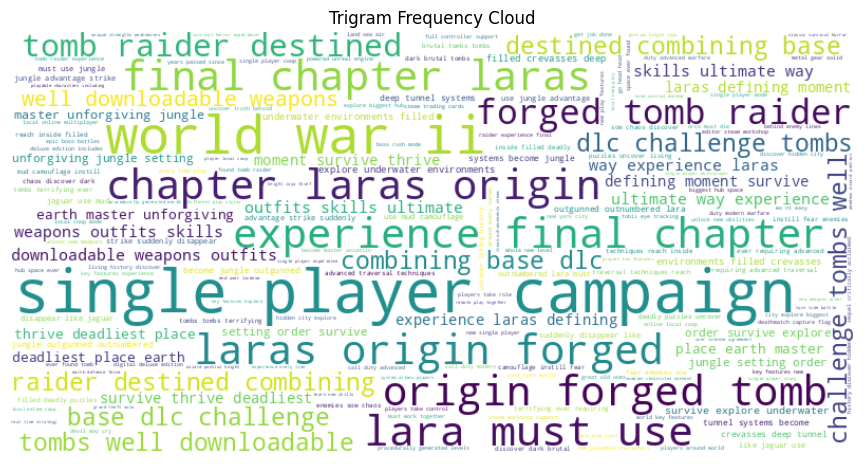

In [14]:
# Create word clouds for each frequency dictionary
def create_wordcloud(freq_dict, title):
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(freq_dict)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(title)
    plt.tight_layout(pad=2)
    plt.show()

create_wordcloud(word_freq, 'Word Frequency Cloud')
create_wordcloud(bigram_freq, 'Bigram Frequency Cloud')
create_wordcloud(trigram_freq, 'Trigram Frequency Cloud')

In addition to more expected popular keywords such as: "new", "unique", two terms stand out in the action game genre:

* "Procedurally generated": These types of games offer a new and different experience everytime the player starts a new game, using randomly generated levels, randomized character skills and abilites, or more, to create unique gameplay each time. For the action game community, getting better at the game and becoming more skilled is something they enjoy. Therefore, it is reasonable that being able to rely on skills to overcome non-repeated levels and random situations in a game is preferred in the action game genre.  

## Keyword Analysis of Top 1000 Games by PCCU Game Descriptions

In [15]:
pccu_df = df.sort_values(by='Peak CCU', ascending=False)
pccu_df = pccu_df.head(1000)
pccu_df = pccu_df[['AppID', 'Name', 'About the game']]
desc_pccu = pccu_df['About the game']

pccu_df['About_cleaned'] = pccu_df['About the game'].apply(remove_non_text_characters).str.lower()
pccu_df['Name_cleaned'] = pccu_df['Name'].apply(remove_non_text_characters).str.lower()

# remove or replace meaningless words manually
def process_row(row):
    about = row['About_cleaned']
    name = row['Name_cleaned']

    if name in about or "grand theft auto" in about or "final fantasy" in about or "mobile suits" in about or "mobile suit" in about or "game" in about:
        about = about.replace(name, "TITLE")
        about = about.replace("grand theft auto", "TITLE")
        about = about.replace("final fantasy", "TITLE")
        about = about.replace("mobile suits", "TITLE")
        about = about.replace("mobile suit", "TITLE")
        about = about.replace("game", "")
        #about = about.replace("play", "")
    return about

# Apply functions
pccu_df['All_cleaned'] = pccu_df.apply(process_row, axis=1)
clean_text = pccu_df['All_cleaned'].apply(remove_stop_words)
entities = clean_text.apply(perform_ner)

non_entity_tokens = []
for text, ents in zip(clean_text, entities):
    non_entity_tokens.append(extract_non_entity_tokens(text, ents))

In [16]:
# Frequency Analysis
flattened_tokens = [token for sublist in non_entity_tokens for token in sublist] # Flatten list of lists
word_freq_pccu = Counter(flattened_tokens)
print("Word Frequency:", word_freq_pccu)

# Count bigrams
bigrams = list(nltk.bigrams(flattened_tokens))
bigram_counts = Counter(bigrams)
bigram_freq_pccu = {' '.join(bigram): count for bigram, count in bigram_counts.items()}
print(bigram_freq_pccu)

# Count trigrams
trigrams = list(nltk.trigrams(flattened_tokens))
trigram_counts = Counter(trigrams)
trigram_freq_pccu = {' '.join(trigram): count for trigram, count in trigram_counts.items()}
print(trigram_freq_pccu)

Word Frequency: Counter({'new': 2471, 'play': 1378, 'world': 1349, 'players': 840, 'experience': 814, 'unique': 727, 'features': 698, 'combat': 602, 'take': 600, 'time': 570, 'mode': 527, 'story': 518, 'weapons': 504, 'multiplayer': 499, 'explore': 487, 'battle': 481, 'every': 476, 'system': 472, 'characters': 465, 'enemies': 451, 'make': 443, 'way': 437, 'including': 407, 'fight': 405, 'war': 403, 'use': 401, 'different': 397, 'online': 391, 'even': 390, 'build': 390, 'choose': 390, 'player': 360, 'create': 360, 'character': 359, 'friends': 354, 'like': 350, 'action': 347, 'team': 339, 'set': 339, 'campaign': 339, 'adventure': 336, 'skills': 327, 'abilities': 321, 'get': 315, 'also': 315, 'across': 313, 'life': 311, 'powerful': 306, 'key': 305, 'discover': 301, 'original': 290, 'city': 287, 'find': 281, 'nt': 278, 'series': 275, 'battles': 275, 'become': 272, 'control': 271, 'modes': 265, 'power': 262, 'full': 260, 'together': 254, 'content': 252, 'amp': 246, 'epic': 246, 'support': 2

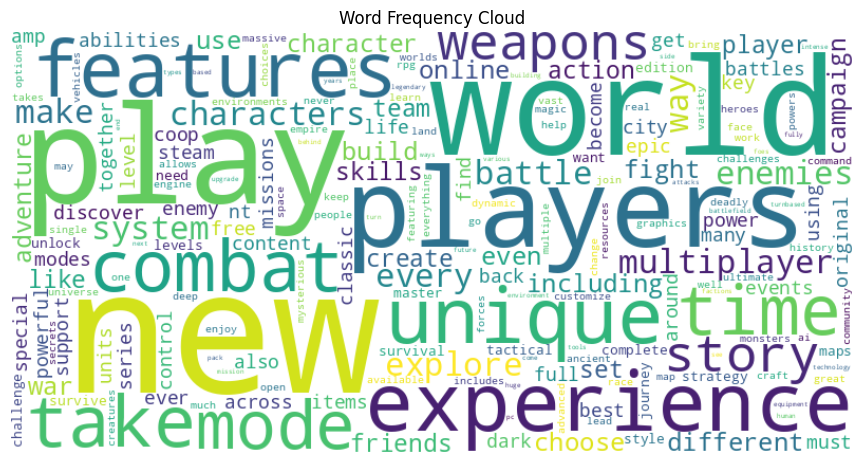

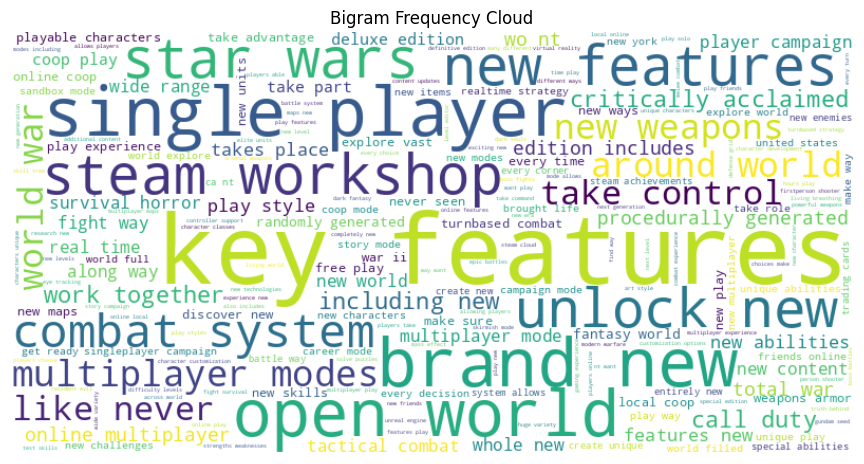

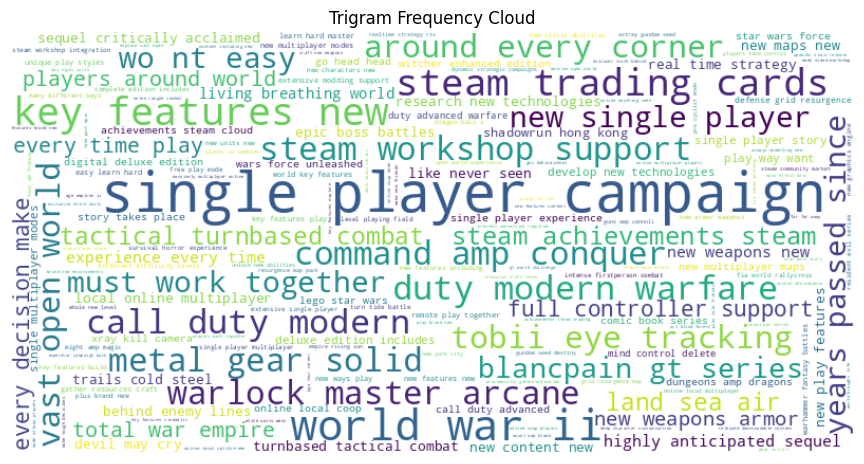

In [17]:
# Create word clouds for each frequency dictionary
create_wordcloud(word_freq_pccu, 'Word Frequency Cloud')
create_wordcloud(bigram_freq_pccu, 'Bigram Frequency Cloud')
create_wordcloud(trigram_freq_pccu, 'Trigram Frequency Cloud')

Doing the same with the top 1000 games by peak concurrent players:

* "Steam trading cards": These are digital items can be bought and sold on the platform and are dropped randomly during play. Whether for monetary gains or bragging rights, players might be incentivized to play a game with this feature.

* "Single player campaign": The 2023 Game Development Report, made in partnership with Rendered VC, surveyed 537 studios from across the globe, and revealed that 955 of game developers are making or maintaing a live-service game. These games are similar to online games, where players have to be online to access the content and has an in-game shop, such as: Fortnite. While more and more publishers turn towards creating live-service games to continuously profit on in-game purchases, the trigram reveals that the most played games on Steam still has a single player campaign. To developers and publishers, this may indicate that in addition to live-service/always-online content, including some degree of single player content might be a way to increase intent-to-purchase.

# Data Visualization - Marketplace and Genre Trends Dashboard

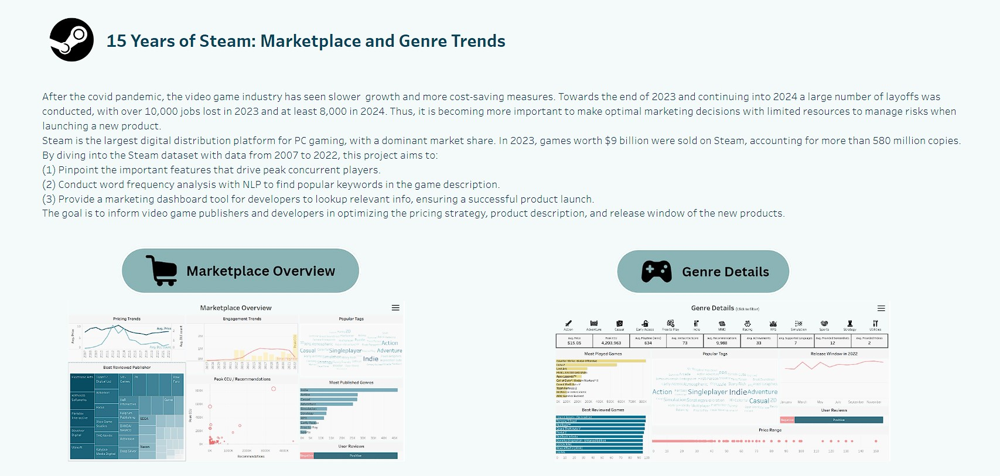

## Marketplace Trends

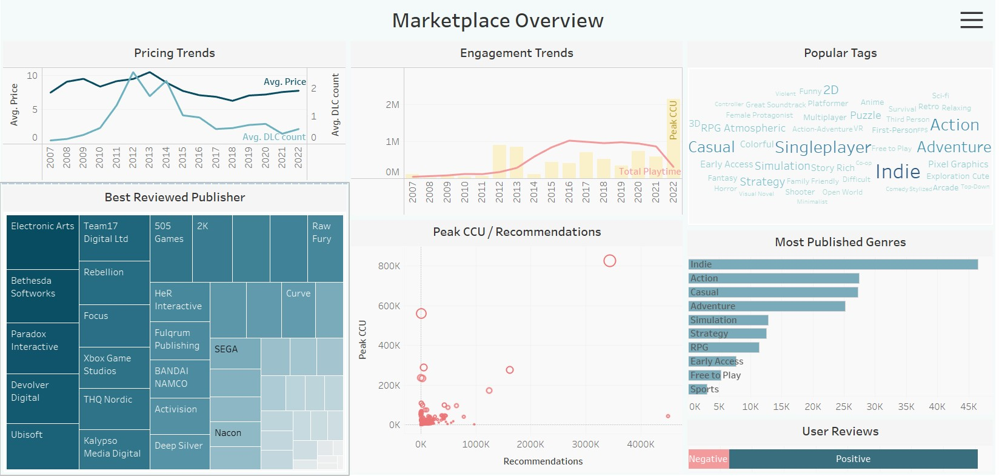

The Marketplace Overview dashboard provide a high-level summary of the Steam marketplace.
Some interesting insights are:
* The average price of games gradually increased from 2007 and reached the high point in 2013, but saw a steady decrease while finally reaching the lowest point during the COVID pandemic.
* Both the most-used tag and most-published genre is "indie", serving as a clear indicator that independent-developed games are the hottest thing on the Steam platform. Indie games are a very generalized category and have a lower barrier to entry. This means that more developers with less resources push their game into the marketplace, creating a diverse selection for consumers. These independent games can have very short playtime, basic art representation, or limited scope.
* The top 5 best reviewed publishers are Electronic Arts (EA), Bethesda Softworks, Paradox Interactive, Devolver Digital and Ubisoft. Most of these publishers possess well-established series, especially EA, which holds many licensed sports games such as NBA, FIFA, and NFL games. Creating new games based on a successful formula might lead to an overall higher review score across all their assets. It is interesting to note that one indie game publisher, Devolver Digital has also made the list, which again proves the success of independent games that cost less resources to create and rely more on innovative gameplay or story-telling elements.

## Genre Trends

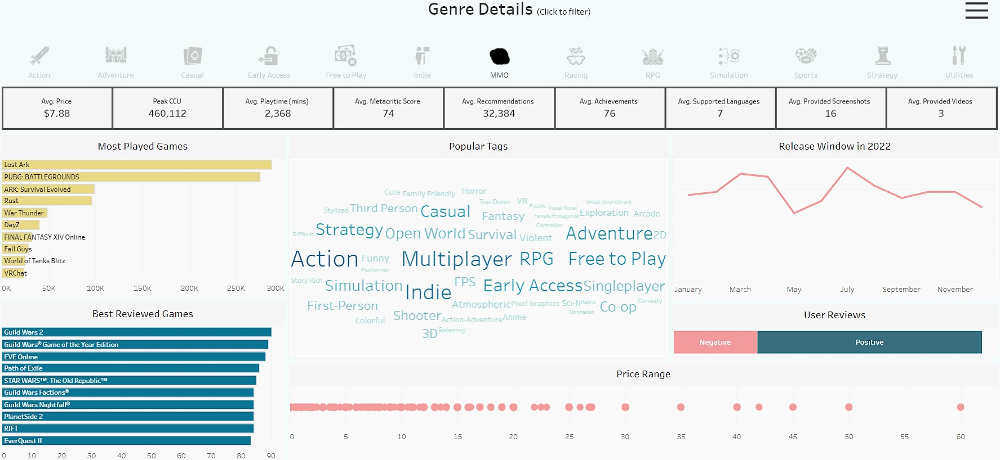

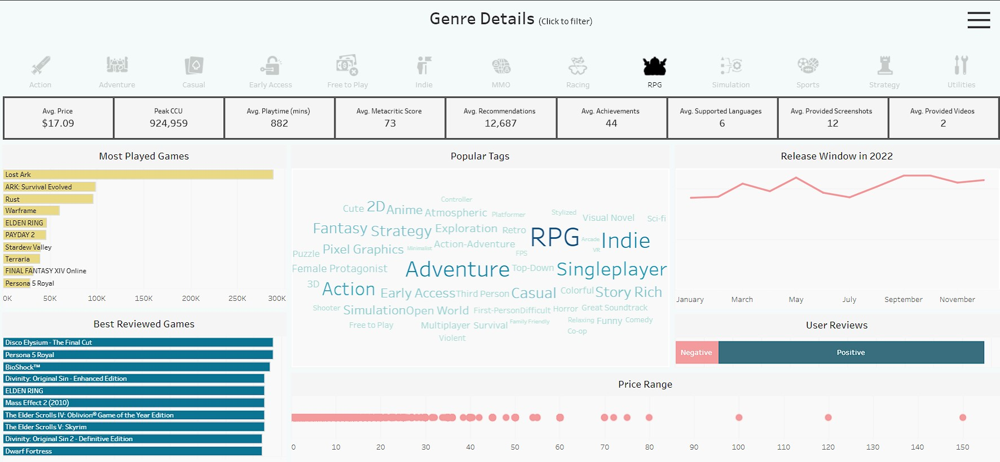

Switching to the Genre Details dashboard, users can click the genres above to see genre-specific trends.

Proceeding to compare Massively-Multiplayer Online and Role-Playing Games as an example:

* The Release Window in 2022 is a line chart of the game release trends in the second-to-last year of this dataset. Publishers can use this chart to get a sense of the amount of games release each month to decide whether to avoid competition or follow the popular release months. For instance, MMOs' reach the peak in July, which is the summer season. For online games, students on vacation, who has more time to invest in MMOs, are an important segment to capture. While RPGs, which are mostly single-player focused, have a more consistent release cycle that does not greatly fluxuate between seasons.

# Conclusion

By examining key metrics such as peak concurrent players, Metacritic scores, and game descriptions, this report identifies several important factors that can influence a game's success on the platform and provides valuable insights for video game publishers and developers looking to optimize their product launches and store page visibility.

The correlation analysis revealed that the number of positive reviews, negative reviews, and recommendations are strongly associated with peak concurrent players. Interestingly, even negative reviews showed a positive correlation with player numbers, particularly for multiplayer games that receive frequent updates. This suggests that engagement and ongoing development can drive player interest regardless of mixed reception.

Genre and tag analysis showed that while RPGs tend to receive higher average Metacritic scores, action games dominate in terms of peak concurrent players. This indicates that critical acclaim and player engagement don't always align, and developers should consider their priorities when choosing a genre focus. The tag analysis revealed that specific gameplay elements like "addictive" and "VR Only" are associated with higher Metacritic scores, providing guidance for effective tagging strategies.

The NLP-based keyword analysis of game descriptions uncovered valuable trends in effective marketing language. For action games, terms like "procedurally generated" stood out, indicating player interest in replayability and unique experiences. Among the top 1000 games by peak concurrent players, phrases such as "Steam trading cards" and "single player campaign" were prominent. This highlights the importance of platform-specific features and traditional gameplay modes, even in an era increasingly focused on live-service games.

Based on these findings, I recommend that developers and publishers:

1. Prioritize ongoing engagement and updates, especially for multiplayer games
2. Carefully consider genre choice based on goals (critical acclaim vs. player numbers)
3. Utilize specific, high-performing tags that accurately represent game features
4. Incorporate popular keywords and phrases in game descriptions, tailored to the game's genre and features
5. Consider including platform-specific features like Steam trading cards
6. Don't neglect single-player content, even when focusing on multiplayer or live-service elements

By leveraging these data-driven insights, game creators can better position their products for success on the Steam platform, potentially increasing their chances of achieving higher player counts, positive reception, and ultimately, commercial success.

# References

* https://gamedevreports.substack.com/p/video-game-insights-state-of-the
* https://en.wikipedia.org/wiki/Impact_of_the_COVID-19_pandemic_on_the_video_game_industry
* https://www.gamesindustry.biz/report-95-of-studios-are-working-on-or-aim-to-release-a-live-service-game
